# **Tutorial** - BERTopic Best Practices

Through the nature of BERTopic, its modularity, many variations of the topic modeling technique is possible. However, during the development and through the usage of the package, a set of best practices have been developed that generally lead to great results.

The following are a number of steps, parameters, and settings that you can use that will generally improve the quality of the resulting topics. In other words, after going through the quick start and getting a feeling for the API these steps should get you to the next level of performance.

**NOTE:**
    Although these are called *best practices*, it does not necessarily mean that they work across all use cases perfectly. The underlying modular nature of BERTopic is meant to take different use cases into account. After going through these practices it is advised to fine-tune wherever necessary.

<br>

<img src="https://raw.githubusercontent.com/MaartenGr/BERTopic/master/images/logo.png" width="20%">

# Enabling the GPU

First, you'll need to enable GPUs for the notebook:

- Navigate to Edit→Notebook Settings
- select GPU from the Hardware Accelerator drop-down

[Reference](https://colab.research.google.com/notebooks/gpu.ipynb)

# **Installing BERTopic**

We start by installing BERTopic from PyPi:

In [7]:
%%capture
%pip install datasets 


## Restart the Notebook
After installing BERTopic, some packages that were already loaded were updated and in order to correctly use them, we should now restart the notebook.

From the Menu:

Runtime → Restart Runtime

# Data
For this example, we will use a dataset containing abstracts and metadata from [ArXiv articles](https://huggingface.co/datasets/arxiv_dataset).


In [8]:
from datasets import load_dataset

c:\Users\HP 450 G6\anaconda3\envs\dash-env\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [9]:
dataset = load_dataset("CShorten/ML-ArXiv-Papers")["train"]
dataset = dataset[:40000]
# Extract abstracts to train on and corresponding titles
abstracts = dataset["abstract"]
titles = dataset["title"]

In [10]:
len(abstracts)

40000

In [11]:
abstracts[0]

'  The problem of statistical learning is to construct a predictor of a random\nvariable $Y$ as a function of a related random variable $X$ on the basis of an\ni.i.d. training sample from the joint distribution of $(X,Y)$. Allowable\npredictors are drawn from some specified class, and the goal is to approach\nasymptotically the performance (expected loss) of the best predictor in the\nclass. We consider the setting in which one has perfect observation of the\n$X$-part of the sample, while the $Y$-part has to be communicated at some\nfinite bit rate. The encoding of the $Y$-values is allowed to depend on the\n$X$-values. Under suitable regularity conditions on the admissible predictors,\nthe underlying family of probability distributions and the loss function, we\ngive an information-theoretic characterization of achievable predictor\nperformance in terms of conditional distortion-rate functions. The ideas are\nillustrated on the example of nonparametric regression in Gaussian noise.\n'

# **Best Practices**

With feedback from the community throughout the development of BERTopic and the core maintainer's personal experience, there are a number of best practices developed that generally lead to an improved topic model.

The goal of these best practices to quickly guide the user to what is commonly used to speed-up training, improve performance, explore alternatives, etc. Instead of having to search through many issues and discussions, an overview of best practices are discussed here.

To start off, it is important to have a general idea of the pipeline of BERTopic as it relates to many of these best practices.

BERTopic can be viewed as a sequence of steps to create its topic representations. There are five steps to this process:

![https://maartengr.github.io/BERTopic/algorithm/default.svg](https://maartengr.github.io/BERTopic/algorithm/default.svg)

The pipeline above implies significant modularity of BERTopic. Each step in this process was carefully selected such that they are all somewhat independent from one another.

As a result, we can adopt the pipeline to the current state-of-the-art with respect to each individual step:

 ![https://maartengr.github.io/BERTopic/algorithm/modularity.svg](https://maartengr.github.io/BERTopic/algorithm/modularity.svg)

## **Pre-calculate Embeddings**
After having created our data, namely `abstracts`, we can dive into the very first best practice, **pre-calculating embeddings**.

BERTopic works by converting documents into numerical values, called embeddings. This process can be very costly, especially if we want to iterate over parameters. Instead, we can calculate those embeddings once and feed them to BERTopic to skip calculating embeddings each time.

In [12]:
from sentence_transformers import SentenceTransformer

# Pre-calculate embeddings
embedding_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = embedding_model.encode(abstracts, show_progress_bar=True)

c:\Users\HP 450 G6\anaconda3\envs\dash-env\lib\site-packages\huggingface_hub\file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Batches: 100%|██████████| 1250/1250 [3:22:24<00:00,  9.72s/it] 


## **Preventing Stochastic Behavior**
In BERTopic, we generally use a dimensionality reduction algorithm to reduce the size of the embeddings. This is done to prevent the [curse of dimensionality](https://en.wikipedia.org/wiki/Curse_of_dimensionality) to a certain degree.

As a default, this is done with [UMAP](https://github.com/lmcinnes/umap) which is an incredible algorithm for reducing dimensional space. However, by default, it shows stochastic behavior which creates different results each time you run it. To prevent that, we will need to set a `random_state` of the model before passing it to BERTopic.

As a result, we can now fully reproduce the results each time we run the model.

In [15]:
from umap import UMAP

umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)

## **Controlling Number of Topics**
There is a parameter to control the number of topics, namely `nr_topics`. This parameter, however, merges topics after they have been created. It is a parameter that supports creating a fixed number of topics.

However, it is advised to control the number of topics through the cluster model which is by default HDBSCAN. HDBSCAN has a parameter, namely min_cluster_size that indirectly controls the number of topics that will be created.

A higher `min_cluster_size` will generate fewer topics and a lower `min_cluster_size` will generate more topics.

Here, we will go with `min_cluster_size=150` to prevent too many micro-clusters from being created:

In [19]:
from hdbscan import HDBSCAN

hdbscan_model = HDBSCAN(min_cluster_size=150, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

## **Improving Default Representation**
The default representation of topics is calculated through [c-TF-IDF](https://maartengr.github.io/BERTopic/algorithm/algorithm.html#5-topic-representation). However, c-TF-IDF is powered by the [CountVectorizer](https://maartengr.github.io/BERTopic/getting_started/vectorizers/vectorizers.html) which converts text into tokens. Using the CountVectorizer, we can do a number of things:

* Remove stopwords
* Ignore infrequent words
* Increase

In other words, we can preprocess the topic representations **after** documents are assigned to topics. This will not influence the clustering process in any way.

Here, we will ignore English stopwords and infrequent words. Moreover, by increasing the n-gram range we will consider topic representations that are made up of one or two words.

In [20]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer_model = CountVectorizer(stop_words="english", min_df=2, ngram_range=(1, 2))

## **Additional Representations**
Previously, we have tuned the default representation but there are quite a number of [other topic representations](https://maartengr.github.io/BERTopic/getting_started/representation/representation.html) in BERTopic that we can choose from. From [KeyBERTInspired](https://maartengr.github.io/BERTopic/getting_started/representation/representation.html#keybertinspired) and [PartOfSpeech](https://maartengr.github.io/BERTopic/getting_started/representation/representation.html#partofspeech), to [OpenAI's ChatGPT](https://maartengr.github.io/BERTopic/getting_started/representation/llm.html#chatgpt) and [open-source](https://maartengr.github.io/BERTopic/getting_started/representation/llm.html#langchain) alternatives, many representations are possible.

In BERTopic, you can model many different topic representations simultanously to test them out and get different perspectives of topic descriptions. This is called [multi-aspect](https://maartengr.github.io/BERTopic/getting_started/multiaspect/multiaspect.html) topic modeling.

Here, we will demonstrate a number of interesting and useful representations in BERTopic:

* KeyBERTInspired
  * A method that derives inspiration from how KeyBERT works
* PartOfSpeech
  * Using SpaCy's POS tagging to extract words
* MaximalMarginalRelevance
  * Diversify the topic words
* OpenAI
  * Use ChatGPT to label our topics


In [37]:
from bertopic.representation import KeyBERTInspired, TextGeneration
from transformers import pipeline


# KeyBERT
keybert_model = KeyBERTInspired()


# Flan-T5
prompt = """I have a topic that contains the following documents:
[DOCUMENTS]
The topic is described by the following keywords: [KEYWORDS]

Based on the information above, extract a highly descriptive topic label."""

generator = pipeline('text2text-generation', model='google/flan-t5-base')
T5_model = TextGeneration(generator, prompt=prompt, nr_docs=2)

# All representation models
representation_model = {
    "KeyBERT": keybert_model,
    "Flan-T5": T5_model,
    "KeyBERT-T5": [keybert_model, T5_model]
}

## **Training**
Now that we have a set of best practices, we can use them in our training loop. Here, several different representations, keywords and labels for our topics will be created. If you want to iterate over the topic model it is advised to use the pre-calculated embeddings as that significantly speeds up training.

In [38]:
from bertopic import BERTopic

topic_model = BERTopic(

  # Pipeline models
  embedding_model=embedding_model,
  umap_model=umap_model,
  hdbscan_model=hdbscan_model,
  vectorizer_model=vectorizer_model,
  representation_model=representation_model,

  # Hyperparameters
  top_n_words=10,
  verbose=True
)

topics, probs = topic_model.fit_transform(abstracts, embeddings)

2024-06-11 22:26:07,154 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-06-11 22:28:00,174 - BERTopic - Dimensionality - Completed ✓
2024-06-11 22:28:00,185 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-11 22:28:15,447 - BERTopic - Cluster - Completed ✓
2024-06-11 22:28:15,512 - BERTopic - Representation - Extracting topics from clusters using representation models.
100%|██████████| 44/44 [03:28<00:00,  4.74s/it]
2024-06-11 22:38:51,979 - BERTopic - Representation - Completed ✓


In [39]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,KeyBERT,Flan-T5,KeyBERT-T5,Representative_Docs
0,-1,10990,-1_data_learning_model_based,"[data, learning, model, based, algorithm, meth...","[deep learning, neural, neural networks, neura...","[DropNeuron, , , , , , , , , ]","[DropNeuron, , , , , , , , , ]","[ Deep learning, a rebranding of deep neural ..."
1,0,5056,0_model_language_models_speech,"[model, language, models, speech, text, neural...","[natural language, corpus, lstm, recurrent neu...",[Multimodal Language Modeling for Speech-to-Te...,"[Multimodal Language Learning, , , , , , , , , ]",[ Learning a natural language interface for d...
2,1,3237,1_policy_reinforcement_reinforcement learning_...,"[policy, reinforcement, reinforcement learning...","[deep reinforcement, reinforcement learning, p...","[Reinforcement Learning and Control, , , , , ,...","[Reinforcement Learning, , , , , , , , , ]","[ In this work, we consider the problem of mo..."
3,2,1989,2_matrix_rank_sparse_kernel,"[matrix, rank, sparse, kernel, tensor, algorit...","[matrix completion, matrix factorization, rank...","[matrix decomposition, , , , , , , , , ]","[matrix decomposition, , , , , , , , , ]",[ We investigate the sample size requirement ...
4,3,1346,3_generative_gan_gans_latent,"[generative, gan, gans, latent, generative adv...","[networks gans, deep generative, generative ad...","[generative adversarial model, , , , , , , , , ]","[k-means-gan, , , , , , , , , ]",[ After deep generative models were successfu...
5,4,1165,4_adversarial_attacks_attack_adversarial examples,"[adversarial, attacks, attack, adversarial exa...","[adversarial attack, vulnerable adversarial, a...","[Latent Adversarial Training, , , , , , , , , ]","[Latent Adversarial Training, , , , , , , , , ]",[ The burgeoning success of deep learning has...
6,5,968,5_neural_networks_pruning_network,"[neural, networks, pruning, network, deep, acc...","[deep learning, deep neural, neural architectu...",[quantization of convolutional neural networks...,"[quantization of deep neural networks, , , , ,...",[ Large deep neural network (DNN) models pose...
7,6,958,6_graph_graphs_node_network,"[graph, graphs, node, network, nodes, networks...","[graph embedding, graph neural, graph classifi...","[Trple2Vec, , , , , , , , , ]","[Trple2Vec, , , , , , , , , ]",[ Graph embedding is an effective method to r...
8,7,904,7_label_classification_classifier_ensemble,"[label, classification, classifier, ensemble, ...","[label classification, multi label, classifier...","[high speed multi-label classification, , , , ...","[High-speed Multi-Label Classifier, , , , , , ...",[ Classification involves the learning of the...
9,8,869,8_networks_neural_neural networks_network,"[networks, neural, neural networks, network, d...","[relu networks, gradient descent, deep neural,...",[stochastic gradient descent for deep neural n...,[stochastic gradient descent for deep neural n...,[ Activation functions play a key role in pro...


To get all representations for a single topic, we simply run the following:

In [ ]:
topic_model.get_topic(1, full=True)

In [25]:
topic_model.get_document_info(abstracts)

,Document,Topic,Name,Representation,KeyBERT,Flan-T5,KeyBERT-T5,Representative_Docs,Top_n_words,Probability,Representative_document
0,The problem of statistical learning is to co...,22,22_distribution_complexity_epsilon_bounds,"[distribution, complexity, epsilon, bounds, sa...","[sample complexity, complexity, learning theor...",[identity testing for multidimensional histogr...,"[learning theory, , , , , , , , , ]",[ We consider PAC learning of probability dis...,distribution - complexity - epsilon - bounds -...,0.911814,False
1,"In a sensor network, in practice, the commun...",21,21_distributed_communication_sgd_gradient,"[distributed, communication, sgd, gradient, co...","[distributed learning, distributed optimizatio...","[distributed sgd, , , , , , , , , ]","[distributed stochastic gradient descent, , , ...",[ When the data is distributed across multipl...,distributed - communication - sgd - gradient -...,0.865144,False
2,The on-line shortest path problem is conside...,11,11_regret_bandit_arms_arm,"[regret, bandit, arms, arm, armed, bandits, mu...","[bandit algorithms, bandit algorithm, bandit p...","[ucb algorithm for multi armed bandit, , , , ,...","[bandit algorithm, , , , , , , , , ]","[ In this paper, we propose a new multi-objec...",regret - bandit - arms - arm - armed - bandits...,0.619528,False
3,Ordinal regression is an important type of l...,-1,-1_data_learning_model_based,"[data, learning, model, based, algorithm, meth...","[deep learning, neural, neural networks, neura...",[generalized sparse regularizer for deep learn...,"[deep learning, , , , , , , , , ]","[ Deep learning, a rebranding of deep neural ...",data - learning - model - based - algorithm - ...,0.000000,False
4,This paper uncovers and explores the close r...,-1,-1_data_learning_model_based,"[data, learning, model, based, algorithm, meth...","[deep learning, neural, neural networks, neura...",[generalized sparse regularizer for deep learn...,"[deep learning, , , , , , , , , ]","[ Deep learning, a rebranding of deep neural ...",data - learning - model - based - algorithm - ...,0.000000,False
...,...,...,...,...,...,...,...,...,...,...,...
39995,The ability to understand and work with numb...,0,0_model_language_models_speech,"[model, language, models, speech, text, neural...","[natural language, corpus, lstm, recurrent neu...",[language model for speech to text translation...,"[RLST, , , , , , , , , ]",[ Learning a natural language interface for d...,model - language - models - speech - text - ne...,1.000000,False
39996,We introduce Block Sparse Canonical Correlat...,-1,-1_data_learning_model_based,"[data, learning, model, based, algorithm, meth...","[deep learning, neural, neural networks, neura...",[generalized sparse regularizer for deep learn...,"[deep learning, , , , , , , , , ]","[ Deep learning, a rebranding of deep neural ...",data - learning - model - based - algorithm - ...,0.000000,False
39997,A new approach to the sparse Canonical Corre...,-1,-1_data_learning_model_based,"[data, learning, model, based, algorithm, meth...","[deep learning, neural, neural networks, neura...",[generalized sparse regularizer for deep learn...,"[deep learning, , , , , , , , , ]","[ Deep learning, a rebranding of deep neural ...",data - learning - model - based - algorithm - ...,0.000000,False
39998,A novel precoding method based on supervised...,-1,-1_data_learning_model_based,"[data, learning, model, based, algorithm, meth...","[deep learning, neural, neural networks, neura...",[generalized sparse regularizer for deep learn...,"[deep learning, , , , , , , , , ]","[ Deep learning, a rebranding of deep neural ...",data - learning - model - based - algorithm - ...,0.000000,False


In [28]:
#topic_model.representation_model["Flan-T5"].prompts_

**NOTE**: The labels generated by OpenAI's **ChatGPT** are especially interesting to use throughout your model. Below, we will go into more detail how to set that as a custom label.

**🔥 Tip - Parameters 🔥**
***
If you would like to return the topic-document probability matrix, then it is advised to use `calculate_probabilities=True`. Do note that this can significantly slow down training. To speed it up, use [cuML's HDBSCAN](https://maartengr.github.io/BERTopic/getting_started/clustering/clustering.html#cuml-hdbscan) instead. You could also approximate the topic-document probability matrix with `.approximate_distribution` which will be discussed later.
***

## **(Custom) Labels**
The default label of each topic are the top 3 words in each topic combined with an underscore between them.

This, of course, might not be the best label that you can think of for a certain topic. Instead, we can use `.set_topic_labels` to manually label all or certain topics.

We can also use `.set_topic_labels` to use one of the other topic representations that we had before, like `KeyBERTInspired` or even `OpenAI`.

In [26]:
# Label the topics yourself
#topic_model.set_topic_labels({1: "Space Travel", 7: "Religion"})

# or KeyBERT-T5 labels
T5_topic_labels = {topic: " ".join(list(zip(*values))[0]) for topic, values in topic_model.topic_aspects_["KeyBERT-T5"].items()}
T5_topic_labels[-1] = "Outlier Topic"
topic_model.set_topic_labels(T5_topic_labels)



Now that we have set the updated topic labels, we can access them with the many functions used throughout BERTopic. Most notably, you can show the updated labels in visualizations with the `custom_labels=True` parameters.

In [27]:
topic_model.get_topic_info()

,Topic,Count,Name,CustomName,Representation,KeyBERT,Flan-T5,KeyBERT-T5,Representative_Docs
0,-1,10990,-1_data_learning_model_based,Outlier Topic,"[data, learning, model, based, algorithm, meth...","[deep learning, neural, neural networks, neura...",[generalized sparse regularizer for deep learn...,"[deep learning, , , , , , , , , ]","[ Deep learning, a rebranding of deep neural ..."
1,0,5056,0_model_language_models_speech,RLST,"[model, language, models, speech, text, neural...","[natural language, corpus, lstm, recurrent neu...",[language model for speech to text translation...,"[RLST, , , , , , , , , ]",[ Learning a natural language interface for d...
2,1,3237,1_policy_reinforcement_reinforcement learning_...,Reinforcement Learning,"[policy, reinforcement, reinforcement learning...","[deep reinforcement, reinforcement learning, p...","[Reinforcement Learning, , , , , , , , , ]","[Reinforcement Learning, , , , , , , , , ]","[ In this work, we consider the problem of mo..."
3,2,1989,2_matrix_rank_sparse_kernel,CUR matrix decomposition,"[matrix, rank, sparse, kernel, tensor, algorit...","[matrix completion, matrix factorization, rank...","[CUR matrix decomposition, , , , , , , , , ]","[CUR matrix decomposition, , , , , , , , , ]",[ We investigate the sample size requirement ...
4,3,1346,3_generative_gan_gans_latent,generative adversarial networks,"[generative, gan, gans, latent, generative adv...","[networks gans, deep generative, generative ad...","[generative adversarial model, , , , , , , , , ]","[generative adversarial networks, , , , , , , ...",[ After deep generative models were successfu...
5,4,1165,4_adversarial_attacks_attack_adversarial examples,adversarial training,"[adversarial, attacks, attack, adversarial exa...","[adversarial attack, vulnerable adversarial, a...","[adversarial training, , , , , , , , , ]","[adversarial training, , , , , , , , , ]",[ The burgeoning success of deep learning has...
6,5,968,5_neural_networks_pruning_network,quantization of convolutional neural networks ...,"[neural, networks, pruning, network, deep, acc...","[deep learning, deep neural, neural architectu...",[quantization of convolutional neural networks...,[quantization of convolutional neural networks...,[ Large deep neural network (DNN) models pose...
7,6,958,6_graph_graphs_node_network,graph embedding,"[graph, graphs, node, network, nodes, networks...","[graph embedding, graph neural, graph classifi...","[graph embedding, , , , , , , , , ]","[graph embedding, , , , , , , , , ]",[ Graph embedding is an effective method to r...
8,7,904,7_label_classification_classifier_ensemble,high speed multi label classification,"[label, classification, classifier, ensemble, ...","[label classification, multi label, classifier...","[high speed multi label classification, , , , ...","[high speed multi label classification, , , , ...",[ Classification involves the learning of the...
9,8,869,8_networks_neural_neural networks_network,gradient descent in deep neural networks,"[networks, neural, neural networks, network, d...","[relu networks, gradient descent, deep neural,...",[stochastic gradient descent for deep neural n...,"[gradient descent in deep neural networks, , ,...",[ Activation functions play a key role in pro...


Notice that the overview in `.get_topic_info` now also includes the column `CustomName`. That is the custom label that we just created for each topic.

In [36]:
topic_model.representation_model["Flan-T5"].prompts_


['I have a topic that contains the following documents:\n- Deep learning using multi layer neural networks NNs architecture manifests superb power in modern machine learning systems The trained Deep Neural Networks DNNs are typically large The question we would like to address is whether it is possible to simplify the NN during training process to achieve reasonable performance within an acceptable computational time We presented novel approach of optimising deep neural network through regularisation of net work architecture We proposed regularisers which support simple mechanism of dropping neurons during network training process The method supports the construction of simpler deep neural networks with compatible performance with its simplified version\n- Feature selection with specific multivariate performance measures is the key to the success of many applications such as image retrieval and text classification The existing feature selection methods are usually designed for classifi

### To save figures and load them in the dash app 

import plotly.io as pio

fig_topic_info = topic_model.get_topic_info()
fig_document_info = topic_model.get_document_info(abstracts)
prompts = topic_model.representation_model["Flan-T5"].prompts_


pio.write_json(fig_topic_info, 'dash-nlp/models/fig_topic_info.json')
pio.write_json(fig_document_info, 'dash-nlp/models/fig_document_info.json')

## **Topic-Document Distribution**
If using `calculate_probabilities=True` is not possible, than you can [approximate the topic-document distributions](https://maartengr.github.io/BERTopic/getting_started/distribution/distribution.html) using `.approximate_distribution`. It is a fast and flexible method for creating different topic-document distributions.

In [31]:
# `topic_distr` contains the distribution of topics in each document
topic_distr, _ = topic_model.approximate_distribution(abstracts, window=8, stride=4)

100%|██████████| 118/118 [04:35<00:00,  2.34s/it]


Next, lets take a look at a specific abstract and see how the topic distribution was extracted:

In [32]:
abstract_id = 10
print(abstracts[abstract_id])

  Speaker identification is a powerful, non-invasive and in-expensive biometric
technique. The recognition accuracy, however, deteriorates when noise levels
affect a specific band of frequency. In this paper, we present a sub-band based
speaker identification that intends to improve the live testing performance.
Each frequency sub-band is processed and classified independently. We also
compare the linear and non-linear merging techniques for the sub-bands
recognizer. Support vector machines and Gaussian Mixture models are the
non-linear merging techniques that are investigated. Results showed that the
sub-band based method used with linear merging techniques enormously improved
the performance of the speaker identification over the performance of wide-band
recognizers when tested live. A live testing improvement of 9.78% was achieved



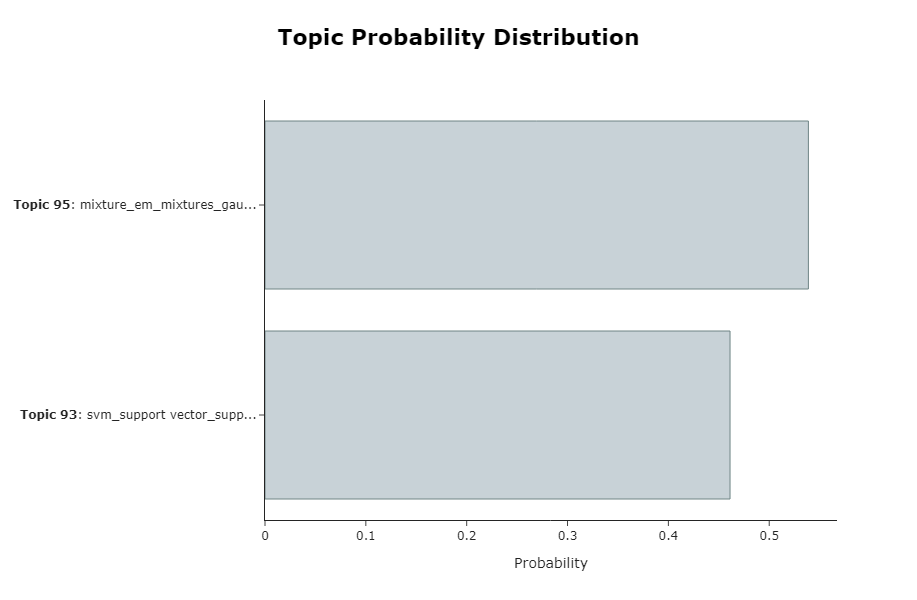

In [33]:
# Visualize the topic-document distribution for a single document
topic_model.visualize_distribution(topic_distr[abstract_id])

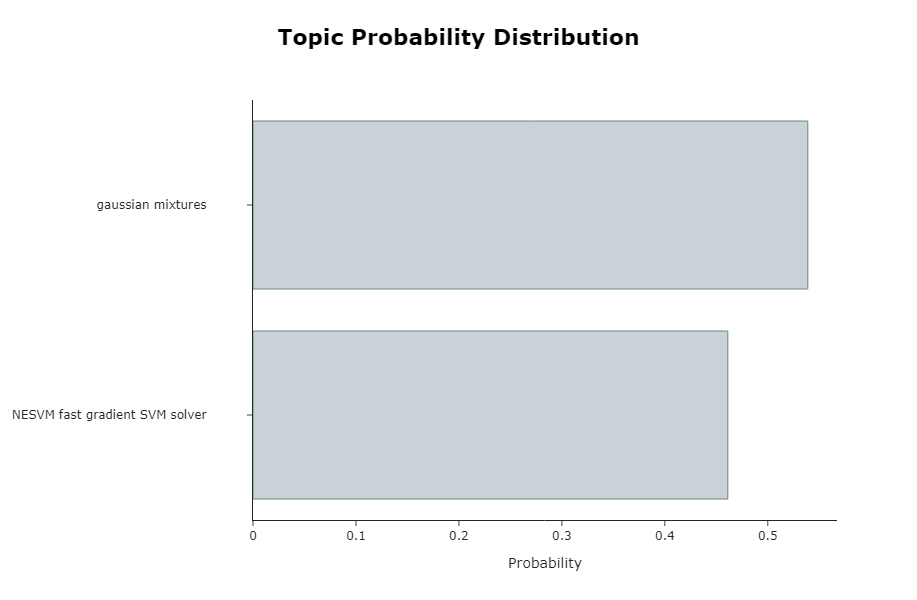

In [34]:
# Visualize the topic-document distribution for a single document
topic_model.visualize_distribution(topic_distr[abstract_id], custom_labels=True)

It seems to have extracted a number of topics that are relevant and shows the distributions of these topics across the abstract. We can go one step further and visualize them on a token-level:

In [35]:
# Calculate the topic distributions on a token-level
topic_distr, topic_token_distr = topic_model.approximate_distribution(abstracts[abstract_id], calculate_tokens=True)

# Visualize the token-level distributions
df = topic_model.visualize_approximate_distribution(abstracts[abstract_id], topic_token_distr[0])
df

100%|██████████| 1/1 [00:00<00:00,  2.46it/s]


,Speaker,identification,is,powerful,non,invasive,and,in,expensive,biometric,technique,The,recognition,accuracy,however,deteriorates,when,noise,levels,affect,specific,band,of,frequency,In,this,paper,we,present,sub,band,based,speaker,identification,that,intends,to,improve,the,live,testing,performance,Each,frequency,sub,band,is,processed,and,classified,independently,We,also,compare,the,linear,and,non,linear,merging,techniques,for,the,sub,bands,recognizer,Support,vector,machines,and,Gaussian,Mixture,models,are,the,non,linear,merging,techniques,that,are,investigated,Results,showed,that,the,sub,band,based,method,used,with,linear,merging,techniques,enormously,improved,the,performance,of,the,speaker,identification,over,the,performance,of,wide,band,recognizers,when,tested,live,live,testing,improvement,of,78,was,achieved
2_speech_audio_speaker_music,0.113,0.113,0.113,0.113,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.101,0.101,0.101,0.101,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.110,0.229,0.348,0.467,0.356,0.238,0.119,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
53_gp_gaussian_gaussian process_gps,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.136,0.272,0.272,0.272,0.136,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
61_emotion_emotion recognition_recognition_facial,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.116,0.116,0.116,0.116,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
91_handwritten_text_character_recognition,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.117,0.117,0.117,0.117,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
93_svm_support vector_support_vector,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0

**🔥 Tip - `use_embedding_model` 🔥**
***
As a default, we compare the c-TF-IDF calculations between the token sets and all topics. Due to its bag-of-word representation, this is quite fast. However, you might want to use the selected embedding_model instead to do this comparison. Do note that due to the many token sets, it is often computationally quite a bit slower:

```python
topic_distr, _ = topic_model.approximate_distribution(docs, use_embedding_model=True)
```
***




## **Outlier Reduction**
By default, HDBSCAN generates outliers which is a helpful mechanic in creating accurate topic representations. However, you might want to assign every single document to a topic. We can use `.reduce_outliers` to map some or all outliers to a topic:

In [36]:
# Reduce outliers
new_topics = topic_model.reduce_outliers(abstracts, topics)

# Reduce outliers with pre-calculate embeddings instead
new_topics = topic_model.reduce_outliers(abstracts, topics, strategy="embeddings", embeddings=embeddings)

100%|██████████| 38/38 [03:26<00:00,  5.42s/it]


**💡  NOTE - Update Topics with Outlier Reduction 💡**
***
After having generated updated topic assignments, we can pass them to BERTopic in order to update the topic representations:

```python
topic_model.update_topics(docs, topics=new_topics)
```

It is important to realize that updating the topics this way may lead to errors if topic reduction or topic merging techniques are used afterwards. The reason for this is that when you assign a -1 document to topic 1 and another -1 document to topic 2, it is unclear how you map the -1 documents. Is it matched to topic 1 or 2.
***

## **Visualize Topics**

With visualizations, we are closing into the realm of subjective "best practices". These are things that I generally do because I like the representations but your experience might differ.

Having said that, there are two visualizations that are my go-to when visualizing the topics themselves:

* `topic_model.visualize_topics()`
* `topic_model.visualize_hierarchy()`

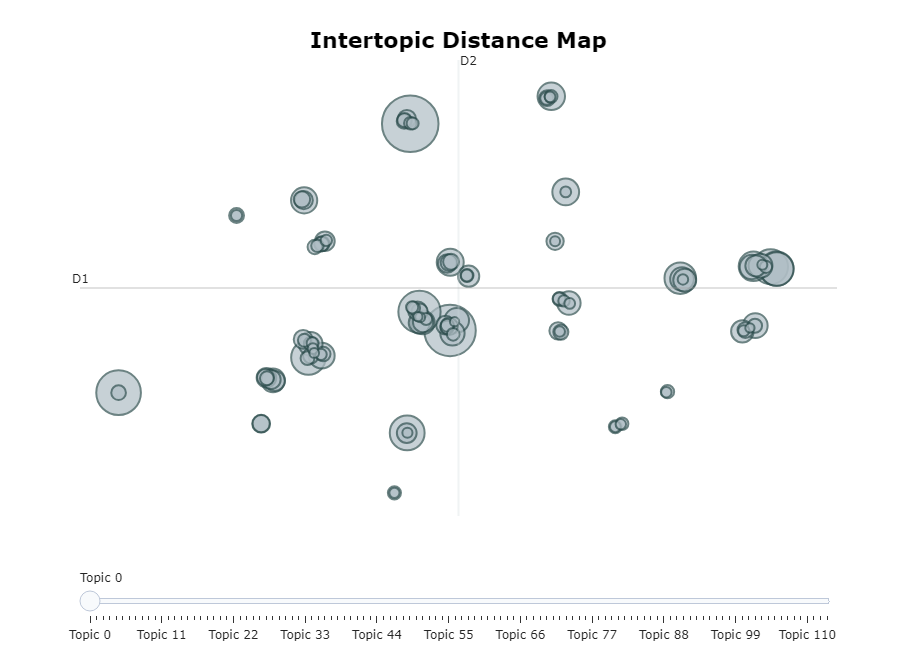

In [ ]:
topic_model.visualize_topics(custom_labels=True)

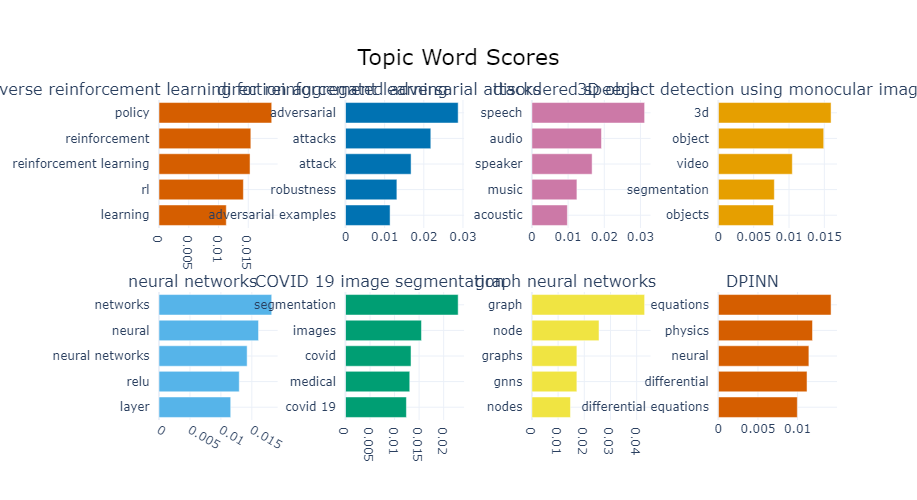

In [ ]:
topic_model.visualize_barchart(custom_labels=True)

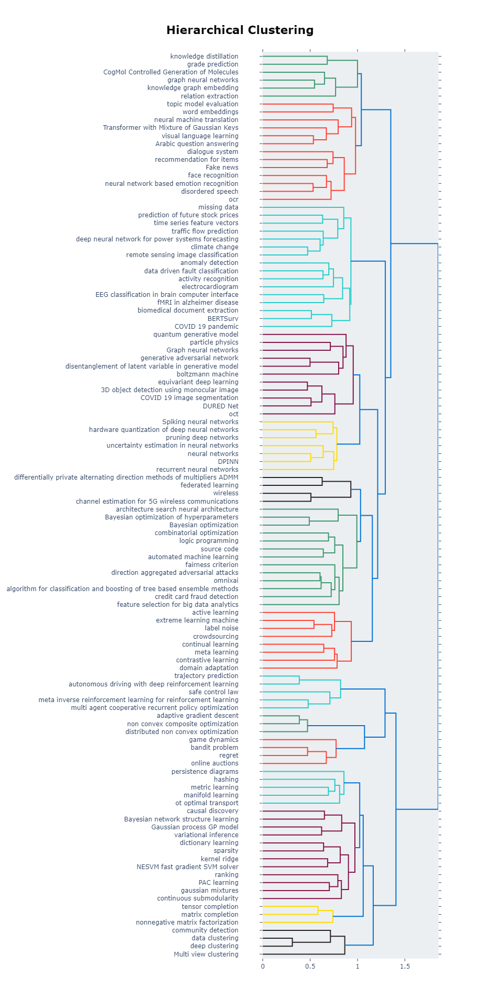

In [39]:
topic_model.visualize_hierarchy(custom_labels=True)

## **Visualize Documents**

When visualizing documents, it helps to have embedded the documents beforehand to speed up computation. Fortunately, we have already done that as a "best practice".

Visualizing documents in 2-dimensional space helps in understanding the underlying structure of the documents and topics.

In [16]:
from umap import UMAP
# Reduce dimensionality of embeddings, this step is optional but much faster to perform iteratively:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)

**We can save the embeddings with safetensors or pickle and load them later to create visualizations**
import numpy as np
from safetensors.numpy import save_file, load_file

#Save embeddings to a file
embeddings_dict = {"embeddings": embeddings}
save_file(embeddings_dict, "dash-nlp/models/embeddings.safetensors")
print("Embeddings saved successfully using safetensors.")

#Load embeddings from a file
loaded_embeddings_dict = load_file("dash-nlp/models/embeddings.safetensors")
loaded_embeddings = loaded_embeddings_dict["embeddings"]
print("Embeddings loaded successfully using safetensors.")

#Load embeddings from a file
loaded_embeddings_dict = load_file("dash-nlp/models/reduced_embeddings.safetensors")
loaded_embeddings = loaded_embeddings_dict["embeddings"]
print("Embeddings loaded successfully using safetensors.")

import pickle
#Save embeddings to a file
with open('dash-nlp/models/reduced_embeddings.pkl', 'wb') as f:
    pickle.dump(reduced_embeddings, f)

with open('dash-nlp/models/embeddings.pkl', 'wb') as f:
    pickle.dump(embeddings, f)

#Load embeddings from a file
with open('dash-nlp/models/embeddings.pkl', 'rb') as f:
    reduced_embeddings = pickle.load(f)

The following plot is **interactive** which means that you can zoom in, double click on a label to only see that one and generally interact with the plot:

In [ ]:
# Visualize the documents in 2-dimensional space and show the titles on hover instead of the abstracts
# NOTE: You can hide the hover with `hide_document_hover=True` which is especially helpful if you have a large dataset
topic_model.visualize_documents(titles, reduced_embeddings=reduced_embeddings, custom_labels=True)

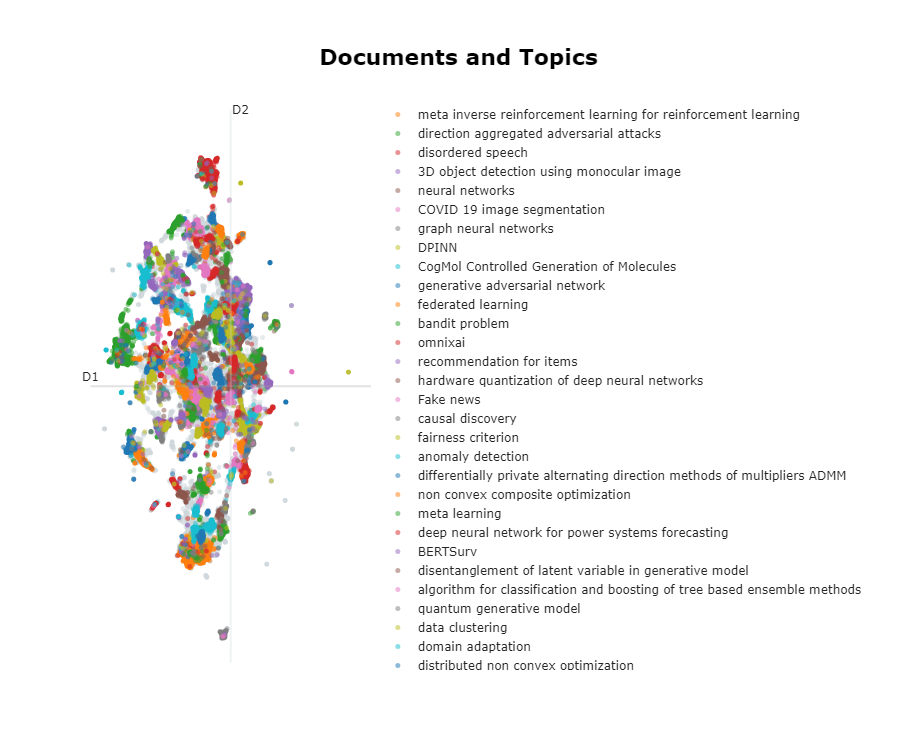

In [42]:
# We can also hide the annotation to have a more clear overview of the topics
topic_model.visualize_documents(titles, reduced_embeddings=reduced_embeddings, custom_labels=True, hide_annotations=True)

**💡  NOTE - 2-dimensional space 💡**
***
Although visualizing the documents in 2-dimensional gives an idea of their underlying structure, there is a risk involved.

Visualizing the documents in 2-dimensional space means that we have lost significant information since the original embeddings were more than 384 dimensions. Condensing all that information in 2 dimensions is simply not possible. In other words, it is merely an **approximation**, albeit quite an accurate one.
***

## **Serialization**

When saving a BERTopic model, there are several ways in doing so. You can either save the entire model with `pickle`, `pytorch`, or `safetensors`.

Personally, I would advise going with `safetensors` whenever possible. The reason for this is that the format allows for a very small topic model to be saved and shared.

When saving a model with `safetensors`, it skips over saving the dimensionality reduction and clustering models. The `.transform` function will still work without these models but instead assign topics based on the similarity between document embeddings and the topic embeddings.

As a result, the `.transform` step might give different results but it is generally worth it considering the smaller and significantly faster model.

In [41]:
embedding_model = "sentence-transformers/all-MiniLM-L6-v2"
topic_model.save("dash-nlp/models/my_model_dir2", serialization="safetensors", save_ctfidf=True, save_embedding_model=embedding_model)

**💡  NOTE - Embedding Model 💡**
***
Using `safetensors`, we are not saving the underlying embedding model but merely a pointer to the model. For example, in the above example we are saving the string `"sentence-transformers/all-MiniLM-L6-v2"` so that we can load in the embedding model alongside the topic model.

This currently only works if you are using a sentence transformer model. If you are using a different model, you can load it in when loading the topic model like this:

```python
from sentence_transformers import SentenceTransformer

# Define embedding model
embedding_model = SentenceTransformer("all-MiniLM-L6-v2")

# Load model and add embedding model
loaded_model = BERTopic.load("path/to/my/model_dir", embedding_model=embedding_model)
```
***

As mentioned above, loading can be done as follows:

In [5]:
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer

# Define embedding model
embedding_model = SentenceTransformer("all-MiniLM-L6-v2")

# Load model and add embedding model
loaded_model = BERTopic.load("my_model_dir1", embedding_model=embedding_model)

** We can save topic_info or document_info table using pandas **
import pandas as pd
topic_info.to_csv('topic_info.csv', index=False)
topic_info = pd.read_csv('topic_info.csv')

In [25]:
fig_visualize_topics = loaded_model.visualize_topics(custom_labels=True)


In [26]:
fig_visualize_topics

## **Inference**

To speed up the inference, we can leverage a "best practice" that we used before, namely serialization. When you save a model as `safetensors` and then load it in, we are removing the dimensionality reduction and clustering steps from the pipeline.

Instead, the assignment of topics is done through cosine similarity of document embeddings and topic embeddings. This speeds up inferences significantly.

To show its effect, let's start by disabling the logger:

In [45]:
from bertopic._utils import MyLogger
logger = MyLogger("ERROR")
loaded_model.verbose = False
topic_model.verbose = False

Then, we run inference on both the loaded model and the non-loaded model:

In [46]:
%timeit loaded_model.transform(abstracts[:100])

19.7 s ± 1.08 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [47]:
%timeit topic_model.transform(abstracts[:100])

25.3 s ± 2.89 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


**1000 documents**

In [ ]:
%timeit loaded_model.transform(abstracts[:1000])

In [ ]:
%timeit topic_model.transform(abstracts[:1000])

**10_000 documents**

In [ ]:
%timeit loaded_model.transform(abstracts[:10000])

In [ ]:
%timeit topic_model.transform(abstracts[:10000])

Based on the above, the `loaded_model` seems to be quite a bit faster for inference than the original `topic_model`.